In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import re
import plotly.graph_objs as go

In [2]:
class ExcelData:
    def __init__(self, filename):
        
    
        #read in excel data
    
        self.df = pd.read_excel(filename)
    
        self.columns = list(self.df.columns)
    
        for col in self.columns:
            setattr(self, col, self.df[col])

In [3]:
historic_unemployment_rates = pd.read_excel('unemployment_rates_historic.xlsx')

In [4]:
annual_gdp_growth = historic_unemployment_rates.YEAR

In [5]:
print(historic_unemployment_rates.head)

<bound method NDFrame.head of     YEAR  UNEMPLOYMENT RATE (DECEMBER)  ANNUAL GDP GROWTH  \
0   1929                         0.032                NaN   
1   1930                         0.087             -0.085   
2   1931                         0.159             -0.064   
3   1932                         0.236             -0.129   
4   1933                         0.249             -0.012   
..   ...                           ...                ...   
88  2017                         0.041              0.023   
89  2018                         0.039              0.029   
90  2019                         0.036              0.023   
91  2020                         0.067             -0.034   
92  2021                         0.039              0.057   

    INFLATION (DECEMBER, YOY)                   NOTABLE EVENTS  
0                       0.006                     Market crash  
1                      -0.064                     Smoot-Hawley  
2                      -0.093             

# import data of laws from csv

In [6]:
laws_historic = pd.read_excel('law_names_final_1953-2022.xlsx')
print(laws_historic.head())

                                  Titles  \
0  H.R.9308 — 117th Congress (2021-2022)   
1  H.R.8982 — 117th Congress (2021-2022)   
2  H.R.8656 — 117th Congress (2021-2022)   
3  H.R.8454 — 117th Congress (2021-2022)   
4  H.R.8404 — 117th Congress (2021-2022)   

                                         Description  
0  To designate the facility of the United States...  
1          Bulk Infant Formula to Retail Shelves Act  
2  To designate the clinic of the Department of V...  
3  Medical Marijuana and Cannabidiol Research Exp...  
4                           Respect for Marriage Act  


In [7]:


# Assuming your data is already in a DataFrame called 'laws_historic'

# Use a regular expression to extract the year range values from the 'Titles' column
laws_historic['Year Range'] = laws_historic['Titles'].str.extract(r'\((\d{4}-\d{4})\)')

# Use a regular expression to extract the ending year from the 'Year Range' column
laws_historic['End Year'] = laws_historic['Year Range'].str.extract(r'-(\d{4})')

# Convert the extracted 'End Year' values to float data type
laws_historic['End Year'] = laws_historic['End Year'].astype(float)

# Drop rows with NaN values in the 'End Year' column
laws_historic = laws_historic.dropna(subset=['End Year'])

# Convert the 'End Year' column to integer data type
laws_historic['End Year'] = laws_historic['End Year'].astype(int)

# Display the updated DataFrame

laws_description = laws_historic['Description']
laws_description

laws_historic

,Titles,Description,Year Range,End Year
0,H.R.9308 — 117th Congress (2021-2022),To designate the facility of the United States...,2021-2022,2022
1,H.R.8982 — 117th Congress (2021-2022),Bulk Infant Formula to Retail Shelves Act,2021-2022,2022
2,H.R.8656 — 117th Congress (2021-2022),To designate the clinic of the Department of V...,2021-2022,2022
3,H.R.8454 — 117th Congress (2021-2022),Medical Marijuana and Cannabidiol Research Exp...,2021-2022,2022
4,H.R.8404 — 117th Congress (2021-2022),Respect for Marriage Act,2021-2022,2022
...,...,...,...,...
24995,H.R.5093 — 83rd Congress (1953-1954),An Act for the Relief of the Survivors of Melv...,1953-1954,1954
24996,H.R.5092 — 83rd Congress (1953-1954),An Act for the Relief of Robert Leon Rohr.,1953-1954,1954
24997,H.R.5090 — 83rd Congress (1953-1954),An Act for the Relief of Mrs. Magdalene Zarnov...,1953-1954,1954
24998,H.R.5086 — 83rd Congress (1953-1954),An Act for the Relief of George Eldred Morgan.,1953-1954,1954


In [19]:

# reverse row order

reversed_indices = np.arange(len(laws_historic)-1, -1, -1)
laws_historic = laws_historic.iloc[reversed_indices].reset_index(drop=True)
laws_historic

,Titles,Description,Year Range,End Year
0,H.R.5085 — 83rd Congress (1953-1954),An Act for the Relief of Mrs. Marie Tcherepnin.,1953-1954,1954
1,H.R.5086 — 83rd Congress (1953-1954),An Act for the Relief of George Eldred Morgan.,1953-1954,1954
2,H.R.5090 — 83rd Congress (1953-1954),An Act for the Relief of Mrs. Magdalene Zarnov...,1953-1954,1954
3,H.R.5092 — 83rd Congress (1953-1954),An Act for the Relief of Robert Leon Rohr.,1953-1954,1954
4,H.R.5093 — 83rd Congress (1953-1954),An Act for the Relief of the Survivors of Melv...,1953-1954,1954
...,...,...,...,...
24995,H.R.8404 — 117th Congress (2021-2022),Respect for Marriage Act,2021-2022,2022
24996,H.R.8454 — 117th Congress (2021-2022),Medical Marijuana and Cannabidiol Research Exp...,2021-2022,2022
24997,H.R.8656 — 117th Congress (2021-2022),To designate the clinic of the Department of V...,2021-2022,2022
24998,H.R.8982 — 117th Congress (2021-2022),Bulk Infant Formula to Retail Shelves Act,2021-2022,2022


Method Two: Also Works

In [10]:

# Declaring columns as variables
Inflation = historic_unemployment_rates[['YEAR','INFLATION (DECEMBER, YOY)']]
Unemployment = historic_unemployment_rates['UNEMPLOYMENT RATE (DECEMBER)']
GDP = historic_unemployment_rates[['YEAR','ANNUAL GDP GROWTH']]

Events = historic_unemployment_rates[['YEAR', 'NOTABLE EVENTS']]


In [11]:
#Cleaning events variable
Events = Events.dropna()
Events

,YEAR,NOTABLE EVENTS
0,1929,Market crash
1,1930,Smoot-Hawley
2,1931,Dust Bowl
3,1932,Hoover's tax hikes
4,1933,FDR's New Deal
...,...,...
88,2017,Dollar weakened
89,2018,Trump tax cuts
90,2019,Goldilocks economy
91,2020,COVID-19 pandemic and recession


In [12]:

# Create a mask to filter rows with non-empty events
mask = Events["NOTABLE EVENTS"].str.contains(r'\S')

# Create a new DataFrame with only the rows containing non-empty events
df_filtered = Events[mask]
#config = {'responsive': False}
fig = px.scatter(
    df_filtered,
    x="YEAR",
    
    hover_data=["YEAR", "NOTABLE EVENTS"],
    title="Notable Events",
    labels={"YEAR": "Year", "NOTABLE EVENTS": "Event"},
)

fig.update_traces(
    marker=dict(size=12, line=dict(width=2, color="DarkSlateGrey")),
    selector=dict(mode="markers"),
)
fig.update_layout(width= 2500, height= 800)

fig.update_xaxes(dtick=5)
fig.show()

In [13]:
print(Inflation.columns)

Index(['YEAR', 'INFLATION (DECEMBER, YOY)'], dtype='object')


<AxesSubplot:xlabel='YEAR'>

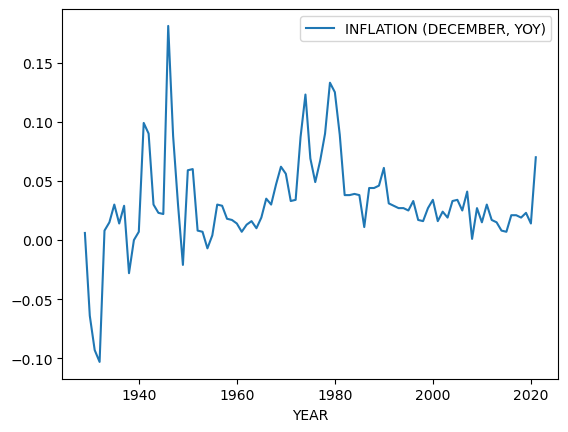

In [14]:
Inflation = Inflation.set_index('YEAR')
Inflation.plot()

In [15]:
print(Inflation.columns)

Index(['INFLATION (DECEMBER, YOY)'], dtype='object')


In [16]:
GDP = GDP[~np.isnan(GDP)]
GDP

,YEAR,ANNUAL GDP GROWTH
0,1929,NaN
1,1930,-0.085
2,1931,-0.064
3,1932,-0.129
4,1933,-0.012
...,...,...
88,2017,0.023
89,2018,0.029
90,2019,0.023
91,2020,-0.034


In [20]:

mask = laws_historic["Description"].str.contains(r'\S')

# Create a new DataFrame with only the rows containing non-empty events
df_filtered = laws_historic[mask]

# Group the filtered data by 'End Year' and count the number of laws passed
laws_count = df_filtered.groupby("End Year").size().reset_index(name="Laws_Count")



fig = px.scatter(
    df_merged,
    x="End Year",
    y="Laws_Count",
    title="Number of Laws Passed Per Year (Without Description) and Inflation Rate",
    labels={"End Year": "Year", "Laws_Count": "Number of Laws"},
    hover_data=["Titles", "Year Range", "End Year", "Description"],
)

fig.add_trace(
    go.Scatter(
        x=Inflation.index,
        y=Inflation['INFLATION (DECEMBER, YOY)'],
        mode="lines",
        name="Inflation Rate",
        line=dict(color="red"),
        yaxis="y2",
    )
)
# Filter and create the scatter plot for notable events
mask = Events["NOTABLE EVENTS"].str.contains(r'\S')
df_events = Events[mask]
fig.add_trace(
    go.Scatter(
        x=df_events["YEAR"],
        y=[0]*len(df_events),  # set all y-values to 0
        mode="markers",
        hovertext=df_events["NOTABLE EVENTS"],
        name="Notable Events",
        marker=dict(symbol='triangle-up', size=12, line=dict(width=2, color="DarkSlateGrey"), color="green"),
    )
)
fig.update_traces(
    marker=dict(size=12, line=dict(width=2, color="DarkSlateGrey")),
    selector=dict(mode="markers"),
)

fig.update_layout(
    width=2500,
    height=800,
    xaxis=dict(dtick=5),
    yaxis=dict(title="Number of Laws Passed Per Session"),
    yaxis2=dict(title="Inflation Rate", overlaying="y", side="right"),
    plot_bgcolor='white'
)

In [21]:


# Create a mask to filter rows with non-empty events
mask = laws_historic["Description"].str.contains(r'\S')

# Create a new DataFrame with only the rows containing non-empty events
df_filtered = laws_historic[mask]

# Group the filtered data by 'End Year' and count the number of laws passed
laws_count = df_filtered.groupby("End Year").size().reset_index(name="Laws_Count")


fig_law_desc = px.scatter(
    df_filtered,
    x="End Year",
    hover_data=["Titles", "Year Range", "End Year", "Description"],
    title="Total Number of Laws Passed (With Description) and Inflation Rate",
    labels={"End Year": "Year", "Titles": "Title", "Description": "Event"},
)

# Filter and create the scatter plot for notable events
mask = Events["NOTABLE EVENTS"].str.contains(r'\S')
df_events = Events[mask]
fig_law_desc.add_trace(
    go.Scatter(
        x=df_events["YEAR"],
        y=[0]*len(df_events),  # set all y-values to 0
        mode="markers",
        hovertext=df_events["NOTABLE EVENTS"],
        name="Notable Events",
        marker=dict(symbol='triangle-up', size=12, line=dict(width=2, color="DarkSlateGrey"), color="green"),
    )
)

fig_law_desc.add_trace(
    go.Scatter(
        x=Inflation.index,
        y=Inflation['INFLATION (DECEMBER, YOY)'],
        mode="lines",
        name="Inflation Rate",
        line=dict(color="red"),
        yaxis="y2",
        
    )
)

fig_law_desc.update_traces(
    marker=dict(size=12, line=dict(width=2, color="DarkSlateGrey")),
    selector=dict(mode="markers"),
)

fig_law_desc.update_layout(
 
    
    
    width=2500,
    height=800,
    xaxis=dict(dtick=5),
    yaxis=dict(title="Total Number of Laws Passed"),
    yaxis2=dict(title="Inflation Rate", overlaying="y", side="right"),
    plot_bgcolor='white',
)

fig_law_desc.show()
fig_law_desc.write_html("my_figure.html")

fig.show()
